In [1]:
import jax
from jax.config import config
config.update("jax_enable_x64", True)

In [2]:
import jax.numpy as np
import numpy as onp
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from jax import vmap
from sklearn.decomposition import PCA

In [3]:
# !pip install sklearn

In [4]:
plt.rcParams['image.cmap'] = 'hot'
plt.rcParams["text.usetex"] = 'true'
plt.rcParams['figure.dpi'] = 120

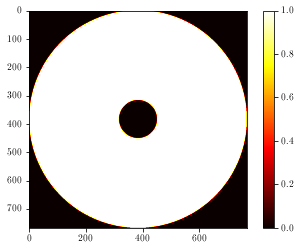

In [5]:
wf_npix = 256
oversample = 3
nslice = 3

npix = wf_npix * oversample
c = (npix - 1) / 2.
xs = (np.arange(npix, dtype=np.float64) - c) / c
XX, YY = np.meshgrid(xs, xs)
RR = np.sqrt(XX ** 2 + YY ** 2)
PHI = np.arctan2(YY, XX)

mask = np.logical_and(RR <= 1, RR >= 0.175).astype(float)
plt.imshow(mask)
plt.colorbar()
plt.show()

In [6]:
# np.save("basis_mask", mask)

In [7]:
# a = 20
# b = 8
# ith = 40

a = 10
b = 8
ith = 20

As = np.arange(-a, a+1)
Bs = 3 * np.arange(0, b+1)
Cs = np.array([-np.pi/2, np.pi/2])
Is = np.arange(-ith, ith+1)

LRHF_fn = lambda A, B, C, RR, PHI: np.cos(A*np.log(RR + 1e-12) + B*PHI + C)
sine_fn = lambda i, RR: np.sin(i * np.pi * RR)
cose_fn = lambda i, RR: np.cos(i * np.pi * RR)

gen_LRHF_basis = vmap(vmap(vmap(LRHF_fn, (None, 0, None, None, None)), (0, None, None, None, None)), (None, None, 0, None, None))
gen_sine_basis = vmap(sine_fn, in_axes=(0, None))
gen_cose_basis = vmap(cose_fn, in_axes=(0, None))

In [8]:
# LRHF_basis = gen_LRHF_basis(As, Bs, Cs, RR, PHI) * np.expand_dims(hf_mask, (2, 1, 0))
# sine_basis = gen_sine_basis(Is, RR) * np.expand_dims(hf_mask, 0)
# cose_basis = gen_cose_basis(Is, RR) * np.expand_dims(hf_mask, 0)

LRHF_basis = gen_LRHF_basis(As, Bs, Cs, RR, PHI).reshape([len(As)*len(Bs)*len(Cs), npix, npix])
sine_basis = gen_sine_basis(Is, RR)
cose_basis = gen_cose_basis(Is, RR)

LRHF_flat = LRHF_basis.reshape([len(As)*len(Bs)*len(Cs), npix*npix])
sine_flat = sine_basis.reshape([len(sine_basis), npix*npix])
cose_flat = cose_basis.reshape([len(cose_basis), npix*npix])

full_basis = np.concatenate([
    LRHF_flat,
    sine_flat,
    cose_flat
])

In [9]:
LRHF_basis.shape

(378, 768, 768)

In [10]:
# # components = pca.components_.reshape([len(full_basis), npix, npix])

# # np.save('test_basis', components)
# nfigs = 50

# ncols = 10
# nrows = 1 + nfigs//ncols

# plt.figure(figsize=(5*ncols, 4*nrows))
# # for i in range(len(components)):
# for i in range(nfigs):
#     plt.subplot(nrows, ncols, i+1)
#     plt.imshow(LRHF_basis[0 + i])
#     # plt.imshow(sine_basis[i])
#     # plt.imshow(cose_basis[i])
#     plt.xticks([])
#     plt.yticks([])
#     # plt.colorbar()
# plt.tight_layout()
# plt.show()

In [11]:
print(LRHF_basis.shape)
print(sine_basis.shape)
print(cose_basis.shape)

(378, 768, 768)
(41, 768, 768)
(41, 768, 768)


In [12]:
print(LRHF_flat.shape)
print(sine_flat.shape)
print(cose_flat.shape)

(378, 589824)
(41, 589824)
(41, 589824)


In [13]:
full_basis.shape

(460, 589824)

In [14]:
%%time
pca = PCA().fit(full_basis)

CPU times: user 4min, sys: 2.84 s, total: 4min 3s
Wall time: 42.5 s


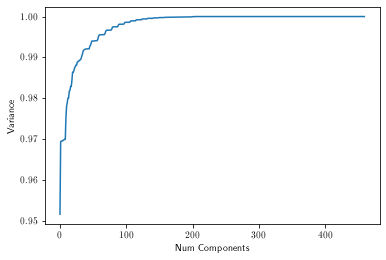

In [15]:
plt.plot(np.arange(len(pca.explained_variance_ratio_)), 1 - pca.explained_variance_ratio_)
# plt.plot(np.arange(len(pca.explained_variance_ratio_)), np.log10(pca.explained_variance_ratio_))
plt.xlabel("Num Components")
plt.ylabel("Variance")
plt.show()

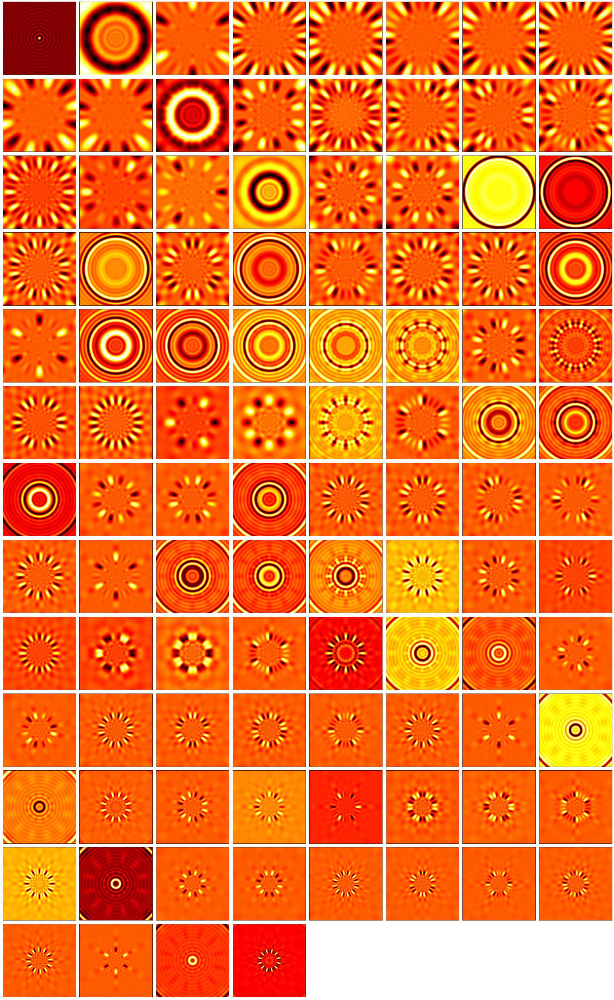

In [16]:
mean = pca.mean_.reshape([npix, npix])
components = pca.components_.reshape([len(full_basis), npix, npix])
basis = np.append(np.array([mean]), components, axis=0)
nfigs = 100

ncols = 8
nrows = 1 + nfigs//ncols

plt.figure(figsize=(4*ncols, 4*nrows))
# for i in range(len(components)):
for i in range(nfigs):
    plt.subplot(nrows, ncols, i+1)
    plt.imshow(basis[i])
    plt.xticks([])
    plt.yticks([])
    # plt.colorbar()
plt.tight_layout()
plt.show()

---

## Save Basis

In [17]:
np.save('basis', basis[:100])
# np.save('test_basis', basis)
# np.save('new_basis', basis)

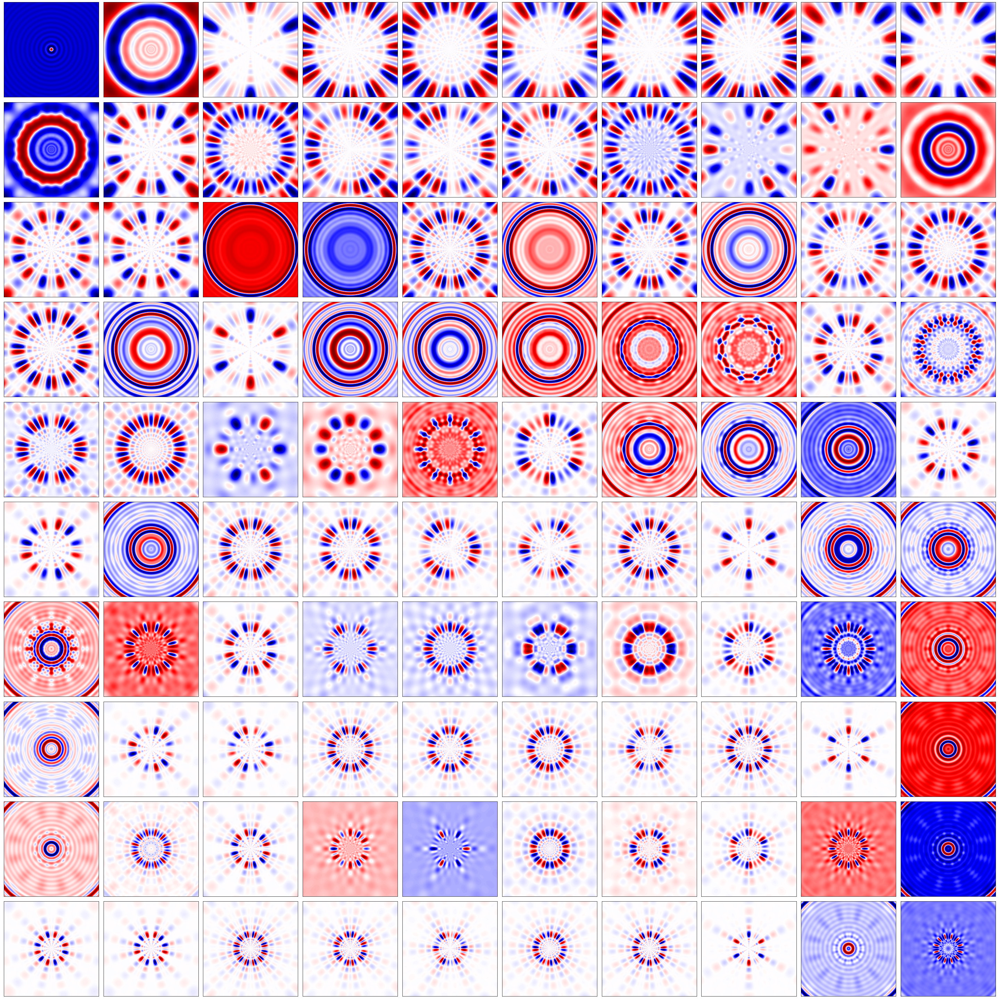

In [18]:
mean = pca.mean_.reshape([npix, npix])
components = pca.components_.reshape([len(full_basis), npix, npix])
basis = np.append(np.array([mean]), components, axis=0)
nfigs = 100

ncols = 10
nrows = 1 + nfigs//ncols

plt.figure(figsize=(4*ncols, 4*nrows))
# for i in range(len(components)):
for i in range(nfigs):
    plt.subplot(nrows, ncols, i+1)
    plt.imshow(basis[i], cmap='seismic')
    plt.xticks([])
    plt.yticks([])
    # plt.colorbar()
plt.tight_layout()
plt.show()

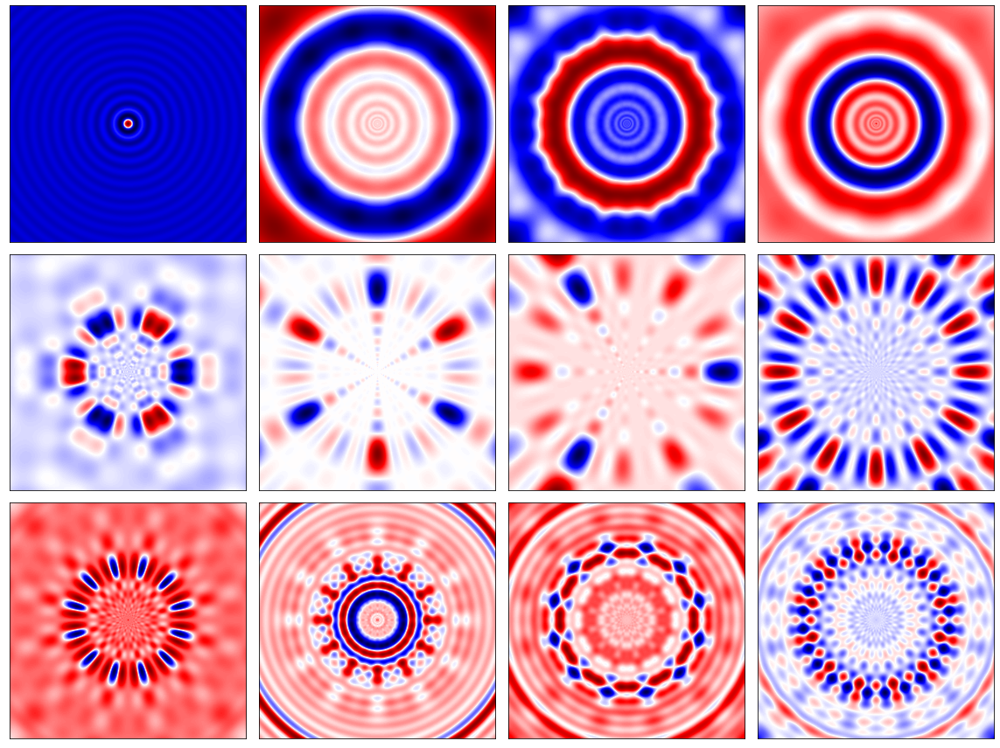

In [34]:
idxs = [0, 1, 10, 19, 
        65, 32, 18, 16,
        61, 60, 37, 39]
nfigs = len(idxs)

ncols = 4
nrows = 3

plt.figure(figsize=(4*ncols, 4*nrows))
for i in range(len(idxs)):
    plt.subplot(nrows, ncols, i+1)
    plt.imshow(basis[idxs[i]], cmap='seismic')
    plt.xticks([])
    plt.yticks([]) 
plt.tight_layout()
plt.savefig("pfigs/basis_sample")
plt.show()

## Random Walk

In [273]:
from jax import vmap

class ApplyBasisCLIMB(eqx.Module):
    """
    NEW DOCTRING:
        TO DO
        
    OLD DOCSTRING:
    Adds an array of phase values to the input wavefront calculated from the OPD
     
    Parameters
    ----------
    nterms: int, equinox.static_field
        The number of zernike terms to apply, ignoring the first two radial
        terms: Piston, Tip, Tilt
        
    basis: jax.numpy.ndarray, equinox.static_field
        Arrays holding the pre-calculated basis terms
        
    coefficients: jax.numpy.ndarray
        Array of shape (nterns) of coefficients to be applied to each 
        Zernike term
    """
    npix: int = eqx.static_field()
    basis: np.ndarray
    coeffs: np.ndarray
    ideal_wavel: float
    
    def __init__(self, basis, coeffs, ideal_wavel):
        self.npix = int(basis.shape[-1])
        self.basis = np.array(basis).astype(float)
        self.coeffs = np.array(coeffs).astype(float)
        self.ideal_wavel = np.array(ideal_wavel).astype(float)

    def __call__(self, params_dict):
        """
        
        """
        # Get relevant parameters
        WF = params_dict["Wavefront"]
        # wavefront = WF.wavefront
        wavel = WF.wavel

        # Get basis phase
        latent = self.get_opd(self.basis, self.coeffs)
        binary_phase = np.pi*self.CLIMB(latent)
        opd = self.phase_to_opd(binary_phase, self.ideal_wavel)
        WF = WF.add_opd(opd)
        # phase = self.opd_to_phase(opd, wavel)
        
#         # Add phase to wavefront
#         phase_out = np.angle(wavefront) + phase
        
#         # Recombine into wavefront
#         wavefront_out = np.abs(wavefront) * np.exp(1j*phase_out)

#         # Update Wavefront Object
#         WF = eqx.tree_at(lambda WF: WF.wavefront,  WF, wavefront_out)
        params_dict["Wavefront"] = WF
        return params_dict
    
    def opd_to_phase(self, opd, wavel):
        return 2*np.pi*opd/wavel
    
    def phase_to_opd(self, phase, wavel):
        return phase*wavel/(2*np.pi)
    
    def get_opd(self, basis, coefficients):
        return np.dot(basis.T, coefficients)
    
    def get_total_opd(self):
        return self.get_opd(self.basis, self.coeffs)
    
    def get_binary_phase(self):
        latent = self.get_opd(self.basis, self.coeffs)
        binary_phase = np.pi*self.CLIMB(latent)
        return binary_phase
    
    def lsq_params(self, img):
        xx, yy = np.meshgrid(np.linspace(0,1,img.shape[0]),np.linspace(0,1,img.shape[1]))
        A = np.vstack([xx.ravel(), yy.ravel(), np.ones_like(xx).ravel()]).T
        matrix = np.linalg.inv(np.dot(A.T,A)).dot(A.T)
        return matrix, xx, yy, A

    def lsq(self, img):
        matrix, _, _, _ = self.lsq_params(img)
        return np.dot(matrix,img.ravel())

    def area(self, img, epsilon = 1e-15):

        a,b,c = self.lsq(img)
        a, b, c = np.where(a==0,epsilon,a), np.where(b==0,epsilon,b), np.where(c==0,epsilon,c)
        x1 = (-b-c)/(a) # don't divide by zero
        x2 = -c/(a) # don't divide by zero
        x1, x2 = np.min(np.array([x1,x2])), np.max(np.array([x1,x2]))
        x1, x2 = np.max(np.array([x1,0])), np.min(np.array([x2,1]))

        dummy = x1 + (-c/b)*x2-(0.5*a/b)*x2**2 - (-c/b)*x1+(0.5*a/b)*x1**2

        # Set the regions where there is a defined gradient
        dummy = np.where(dummy>=0.5,dummy,1-dummy)

        # Colour in regions
        dummy = np.where(np.mean(img)>=0,dummy,1-dummy)

        # rescale between 0 and 1?
        dummy = np.where(np.all(img>0),1,dummy)
        dummy = np.where(np.all(img<=0),0,dummy)

        # undecided region
        dummy = np.where(np.any(img==0),np.mean(dummy>0),dummy)

        # rescale between 0 and 1
        dummy = np.clip(dummy, 0, 1)

        return dummy

    def CLIMB(self, wf, ppsz = 256):
        psz = ppsz * 3

        dummy = np.array(wf.split(ppsz))
        dummy = np.array(dummy.split(ppsz, axis = 2))
        subarray = dummy[:,:,0,0]

        flat = dummy.reshape(-1, 3, 3)
        vmap_mask = vmap(self.area, in_axes=(0))

        soft_bin = vmap_mask(flat).reshape(ppsz, ppsz)

        return soft_bin

In [307]:
# def lsq_params(img):
#     xx, yy = np.meshgrid(np.linspace(0,1,img.shape[0]),np.linspace(0,1,img.shape[1]))
#     A = np.vstack([xx.ravel(), yy.ravel(), np.ones_like(xx).ravel()]).T
#     matrix = np.linalg.inv(np.dot(A.T,A)).dot(A.T)
#     return matrix, xx, yy, A

# def lsq(img):
#     matrix, _, _, _ = lsq_params(img)
#     return np.dot(matrix,img.ravel())

# def area(img, epsilon = 1e-15):

#     a,b,c = lsq(img)
#     a, b, c = np.where(a==0,epsilon,a), np.where(b==0,epsilon,b), np.where(c==0,epsilon,c)
#     x1 = (-b-c)/(a) # don't divide by zero
#     x2 = -c/(a) # don't divide by zero
#     x1, x2 = np.min(np.array([x1,x2])), np.max(np.array([x1,x2]))
#     x1, x2 = np.max(np.array([x1,0])), np.min(np.array([x2,1]))

#     dummy = x1 + (-c/b)*x2-(0.5*a/b)*x2**2 - (-c/b)*x1+(0.5*a/b)*x1**2

#     # Set the regions where there is a defined gradient
#     dummy = np.where(dummy>=0.5,dummy,1-dummy)

#     # Colour in regions
#     dummy = np.where(np.mean(img)>=0,dummy,1-dummy)

#     # rescale between 0 and 1?
#     dummy = np.where(np.all(img>0),1,dummy)
#     dummy = np.where(np.all(img<=0),0,dummy)

#     # undecided region
#     dummy = np.where(np.any(img==0),np.mean(dummy>0),dummy)

#     # rescale between 0 and 1
#     dummy = np.clip(dummy, 0, 1)

#     return dummy

# def CLIMB(wf, ppsz = 256):
#     psz = ppsz * 3

#     dummy = np.array(wf.split(ppsz))
#     dummy = np.array(dummy.split(ppsz, axis = 2))
#     subarray = dummy[:,:,0,0]

#     flat = dummy.reshape(-1, 3, 3)
#     vmap_mask = vmap(area, in_axes=(0))

#     soft_bin = vmap_mask(flat).reshape(ppsz, ppsz)

#     return soft_bin

In [274]:
def toliman_layers(extra_layers=[]):
    wf_npix = 256
    aperture = 0.125
    m2 = 0.02
    fl = 1.32
    fl_shift = 0.
    
    det_npix = 256
    osamp = 5
    det_pixsize =  (6.5e-6) / osamp
        
    layers = [
        CreateWavefront(wf_npix, aperture),
        TiltWavefront(),
        CircularAperture(wf_npix, rmin=m2/aperture, eps=1e-7),
        NormaliseWavefront()]

    [layers.append(layer) for layer in extra_layers]
    
    layers.append(FresnelProp(det_npix, fl, fl_shift, det_pixsize))
    # layers.append(MFT(det_npix, fl, det_pixsize))
    return layers

In [275]:
from dLux import *
from dLux.zernike import zernike_basis

import sys
sys.path.append('../')
from helpers import *

In [276]:
r = arcsec2rad(10)
positions = np.array([[r/2, 0], [-r/2, 0]])
fluxes = np.array([1e6, 1e6])
wavels = 1e-9 * np.linspace(545, 645, 9)

In [286]:
# Base layers
lays = toliman_layers()
aperture = lays[2].array
wf_npix = aperture.shape[0]

# Test Basis
# coeffs = p.load(open('../files/models/rge_models.p', 'rb'))[-1][9].layers[3].coefficients
# # np.save('../files/models/rge_models_coeffs', coeffs)
coeffs = np.load('../files/models/rge_models_coeffs.npy')
basis = np.load("../files/basis/test_basis.npy")[:len(coeffs)]
# basis_layer = ApplyBasisCLIMB(basis, coeffs, wavels.mean())

# # Zernike Basis
# zern_basis = zernike_basis(10, wf_npix, outside=0.)[4:]
# zcoeffs = np.zeros(len(zern_basis))

# # Masks
# basis_mask = phase2opd(basis_layer.get_binary_phase(), wavels.mean())
# egg_mask =  phase2opd(np.pi*scale_mask(np.load("../files/masks/egg_mask.npy"), wf_npix), wavels.mean())
# ttol_mask = phase2opd(np.pi*scale_mask(np.load("../files/masks/ttol_mask.npy"), wf_npix), wavels.mean())

# # Detector Layers
# jitter = 1.
# saturation = 1e6
# # saturation = 750
# det_layers = [ApplyJitter(jitter), ApplySaturation(saturation)]
# # det_layers = [ApplySaturation(saturation)]
# det_layers = []

In [287]:
# Test Osys
latent_layers = toliman_layers([
    ApplyBasisCLIMB(basis, coeffs, np.mean(wavels))])
latent_osys = OpticalSystem(latent_layers, 
                            wavels=wavels, 
                            positions=positions, 
                            fluxes=fluxes)


In [289]:
nterms = 100
step_n = 250

tmax = 2*np.pi
theta = np.linspace(-tmax, tmax, step_n)
shifts = np.linspace(0, 2*tmax, nterms)

# rand_scale = onp.random.rand(nterms).reshape([1, nterms])
rand_scale = np.linspace(1, 4, nterms).reshape([1, nterms])

thetas = theta.reshape([step_n, 1]) + shifts.reshape([1, nterms])
ampls_out = np.sin(rand_scale*thetas)

In [494]:
nterms = 100
# zern_basis = zernike_basis(nterms+3, wf_npix, outside=0.)[3:]

nstep = 250

tmax = np.pi
smax = 2.5
smax = 3
pmax = 10

theta = np.linspace(-tmax, tmax, step_n).reshape([nstep, 1])
# scale = np.linspace(1, smax, nterms).reshape([1, nterms])
scale = onp.random.randint(1, smax, nterms)
# shift = np.linspace(-pmax/2, pmax/2, nterms).reshape([1, nterms])
shift = 2*np.pi*(onp.random.rand(nterms)-0.5).reshape([1, nterms])

print(theta.shape)
print(shifts.shape)
print(scale.shape)

thetas_out = theta*scale + shift
ampls_out = np.sin(thetas_out)

(250, 1)
(100,)
(100,)


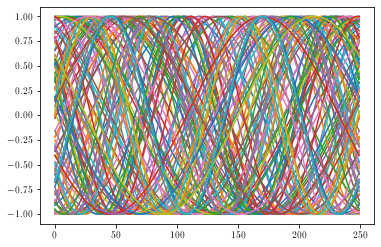

In [495]:
plt.plot(ampls_out)
plt.show()

In [496]:
# plt.plot(thetas * rand_scale, alpha=0.5)
# plt.show()

# plt.plot(ampls_out.T, alpha=0.05)
# plt.show()

In [497]:
# dims = nterms
# basis_small = basis[1:nterms+1]
# basis_out = basis_small/np.max(np.abs(basis_small), axis=(-1, -2)).reshape([nterms, 1, 1])

# # Define parameters for the walk
# step_set = 5e-3 * np.array([-1, 0, 1])
# origin = np.zeros((1,dims))

# # Simulate steps in 2D
# step_shape = (step_n,dims)
# steps = onp.random.choice(a=step_set, size=step_shape)
# path = np.concatenate([origin, steps]).cumsum(0)
# start = path[:1]
# stop = path[-1:]

In [498]:
latents = []
masks = []
psfs = []
# for i in tqdm(range(path.shape[0])):
for i in tqdm(range(ampls_out.shape[0])):
# for i in tqdm(range(50)):
    # c = path[i]
    c = ampls_out[i]
    latent_mask = np.dot(basis_out.T, c)
    mask = np.pi*CLIMB(latent_mask)
    
    # Test Osys
    latent_layers = toliman_layers([
        # ApplyOPD(mask)])
        ApplyBasisCLIMB(basis_out, c, np.mean(wavels))])
    latent_osys = OpticalSystem(latent_layers, 
                                wavels=wavels)
    psf = latent_osys()
    
    
    latents.append(latent_mask)
    masks.append(mask)
    psfs.append(psf)

  0%|          | 0/250 [00:00<?, ?it/s]

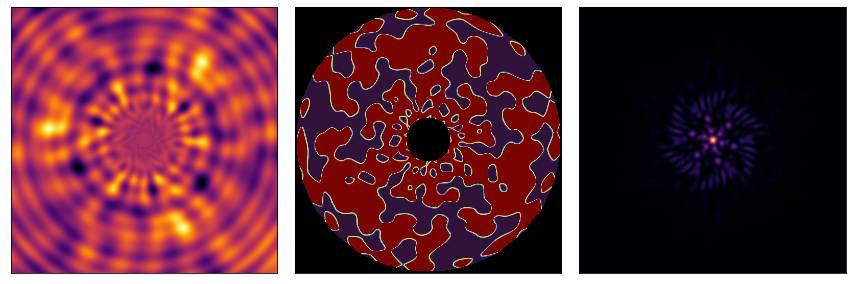

In [499]:
import matplotlib.cm as cmapper
cmaps = ['gnuplot', 'nipy_spectral', 'hsv', 'inferno', 'hot', 'twilight', 'seismic']
j = 3
i = 0
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.imshow(latents[i], cmap='inferno')
plt.xticks([])
plt.yticks([]) 

plt.subplot(1, 3, 2)
inv_support = np.where(aperture < 1)
mask_in = masks[i].at[inv_support].set(np.nan)
cm = cmapper.get_cmap('turbo').copy()
cm.set_bad(color='k', alpha=1)
plt.imshow(mask_in, cmap=cm)
plt.xticks([])
plt.yticks([]) 

plt.subplot(1, 3, 3)
plt.imshow(psfs[i], cmap='inferno')
plt.xticks([])
plt.yticks([]) 

plt.tight_layout()
# plt.savefig(filename, dpi=dpi, facecolor='k')
# plt.close()

In [500]:
dpi = 72
filenames = []
for i in tqdm(range(len(psfs))):
    filename = 'gif_figs/bwalk/{}.png'.format(i)
    
    
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 3, 1)
    plt.imshow(latents[i], cmap='inferno')
    plt.xticks([])
    plt.yticks([]) 

    plt.subplot(1, 3, 2)
    inv_support = np.where(aperture < 1)
    mask_in = masks[i].at[inv_support].set(np.nan)
    cm = cmapper.get_cmap('turbo').copy()
    cm.set_bad(color='k', alpha=1)
    plt.imshow(mask_in, cmap=cm)
    plt.xticks([])
    plt.yticks([]) 

    plt.subplot(1, 3, 3)
    plt.imshow(psfs[i], cmap='inferno')
    plt.xticks([])
    plt.yticks([]) 

    plt.tight_layout()
    plt.savefig(filename, dpi=dpi, facecolor='k')
    plt.close()
    filenames.append(filename)

  0%|          | 0/250 [00:00<?, ?it/s]

In [501]:
nhold = 50
filenames_out = []
for i in range(nhold):
    filenames_out.append(filenames[0])
    
filenames_out += filenames
for i in range(2*nhold):
    filenames_out.append(filenames[-1])
    
filenames_in = filenames_out[::4]

In [503]:
import imageio
kwargs = { 'duration': 0.05}
# kwargs = { 'duration': 0.1}
with imageio.get_writer('bwalk.gif', mode='I', **kwargs) as writer:
    # for filename in tqdm(filenames_out):
    # for filename in tqdm(filenames_in):
    for filename in tqdm(filenames[::2]):
        image = imageio.imread(filename)
        writer.append_data(image)

  0%|          | 0/125 [00:00<?, ?it/s]

/var/folders/28/6s47s91d14ldjdrljs4d1hxw0000gn/T/ipykernel_23146/4286398311.py:8: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


---
---
# Square Basis

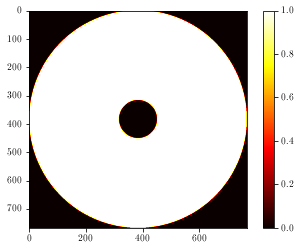

In [472]:
wf_npix = 256
oversample = 3
nslice = 3

npix = wf_npix * oversample
c = (npix - 1) / 2.
xs = (np.arange(npix, dtype=np.float64) - c) / c
XX, YY = np.meshgrid(xs, xs)
RR = np.sqrt(XX ** 2 + YY ** 2)
PHI = np.arctan2(YY, XX)

mask = np.logical_and(RR <= 1, RR >= 0.175).astype(float)
plt.imshow(mask)
plt.colorbar()
plt.show()

In [473]:
# np.save("basis_mask", mask)

In [474]:
ith = 20
Is = np.arange(-ith, ith+1)

sine_fn = lambda i, XX: np.sin(i * np.pi * XX)
cose_fn = lambda i, XX: np.cos(i * np.pi * XX)

gen_sine_basis = vmap(sine_fn, in_axes=(0, None))
gen_cose_basis = vmap(cose_fn, in_axes=(0, None))

In [475]:
sine_basis_X = gen_sine_basis(Is, XX)
sine_basis_Y = gen_sine_basis(Is, YY)
cose_basis_X = gen_cose_basis(Is, XX)
cose_basis_Y = gen_cose_basis(Is, YY)

In [476]:
sine_flat_X = sine_basis_X.reshape([len(sine_basis_X), npix*npix])
cose_flat_X = cose_basis_X.reshape([len(cose_basis_X), npix*npix])
sine_flat_Y = sine_basis_Y.reshape([len(sine_basis_Y), npix*npix])
cose_flat_Y = cose_basis_Y.reshape([len(cose_basis_Y), npix*npix])

full_basis = np.concatenate([
    sine_flat_X,
    sine_flat_Y,
    cose_flat_X,
    cose_flat_Y,
])

In [477]:
full_basis.shape

(164, 589824)

In [43]:
%%time
pca = PCA().fit(full_basis)

CPU times: user 2min 8s, sys: 1.11 s, total: 2min 9s
Wall time: 29.5 s


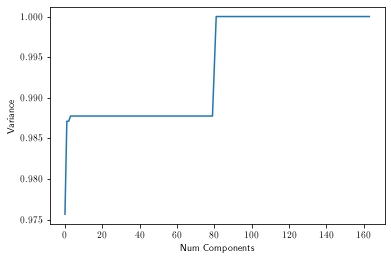

In [44]:
plt.plot(np.arange(len(pca.explained_variance_ratio_)), 1 - pca.explained_variance_ratio_)
# plt.plot(np.arange(len(pca.explained_variance_ratio_)), np.log10(pca.explained_variance_ratio_))
plt.xlabel("Num Components")
plt.ylabel("Variance")
plt.show()

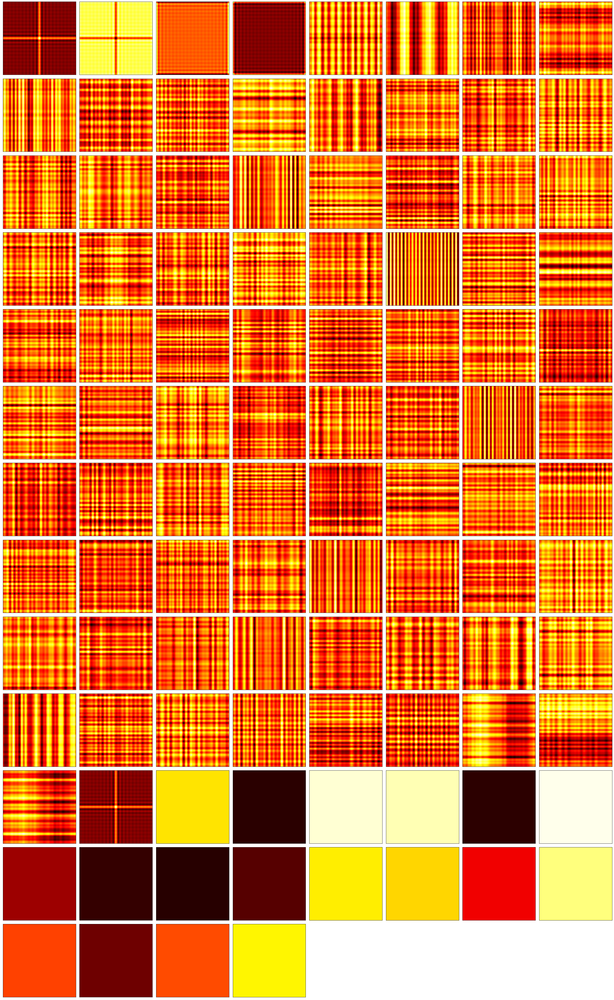

In [45]:
mean = pca.mean_.reshape([npix, npix])
components = pca.components_.reshape([len(full_basis), npix, npix])
basis = np.append(np.array([mean]), components, axis=0)
nfigs = 100

ncols = 8
nrows = 1 + nfigs//ncols

plt.figure(figsize=(4*ncols, 4*nrows))
# for i in range(len(components)):
for i in range(nfigs):
    plt.subplot(nrows, ncols, i+1)
    plt.imshow(basis[i])
    plt.xticks([])
    plt.yticks([])
    # plt.colorbar()
plt.tight_layout()
plt.show()

---

## Save Basis

In [46]:
# np.save('square_basis', basis)